# Introduction
In this notebook, we use various datasets to visualize persistent barcodes. For persistent homology computations, we rely on the [`GUDHI`](https://gudhi.inria.fr/python/latest/) library, a powerful toolkit for Topological Data Analysis (TDA). For visualizations, we use [`matplotlib`](https://matplotlib.org/), which provides extensive tools for static and animated plots. Additional utility functions and custom visualizations are implemented in the accompanying `tda_utils.py` file.


In [2]:
# Import required functions
from tda_utils import *

# Datasets
We begin by uploading/generatings synthetic datasets. We have in total four different datasets.
* Point Cloud with Two Prominent Loops
* Point Cloud with Three Blobs
* Sphere
* Weighted Graph

In [5]:
# Load datasets
pt_cloud1 = np.load('Datasets/point_cloud_in_plane.npy')
X_blobs = np.load('Datasets/blobs.npy')
X_sphere = np.load('Datasets/X_sphere.npy')

# Create a weighted graph data
weights = np.array([
    [0, 1, 0.1],
    [0, 2, 0.8],
    [0, 3, 0.65],
    [0, 4, 0.65],
    [1, 2, 0.8],
    [1, 3, 0.65],
    [1, 4, 0.65],
    [2, 3, 0.8],
    [2, 4, 0.83],
    [3, 4, 0.15]
])

# Create graph and add weighted edges
G = nx.Graph()
G.add_weighted_edges_from(weights)


## Visualize the Datasets
We visualize the four datasets below. The first three are point clouds and the last one is a weighted graph.

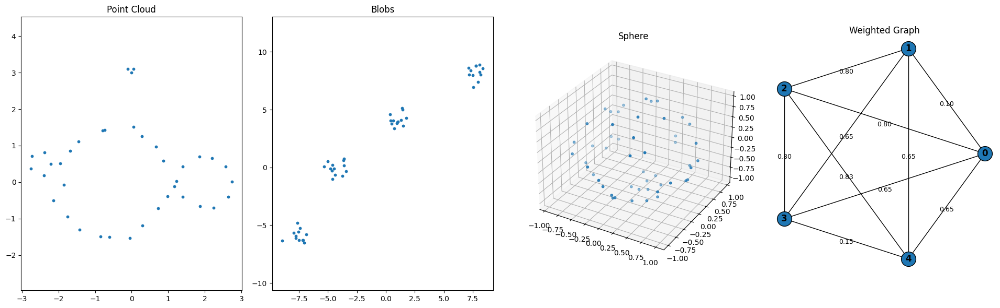

In [10]:
fig = plt.figure(figsize=(24, 6))

# Point Cloud
ax1 = fig.add_subplot(1,5,1)
ax1.scatter(pt_cloud1[:,0],pt_cloud1[:,1],s = 10)
ax1.set_title("Point Cloud")
ax1.axis('equal')

# Blobs
ax2 = fig.add_subplot(1, 5, 2)
ax2.scatter(X_blobs[:, 0], X_blobs[:, 1], s=10)
ax2.set_title("Blobs")
ax2.axis('equal')

# Sphere
ax3 = fig.add_subplot(1, 5, 3, projection='3d')
ax3.scatter(X_sphere[:, 0], X_sphere[:, 1], X_sphere[:, 2], s=10)
ax3.set_title("Sphere")


# Weighted Graph
ax4 = fig.add_subplot(1, 5, 4)
G = nx.Graph()
G.add_weighted_edges_from(weights)
plot_weighted_graph(weights,ax = ax4)
# pos = nx.circular_layout(G)
# nx.draw(G, pos, with_labels=True, node_color='lightblue', node_size=700, font_weight='bold', ax=ax4)
# edge_labels = nx.get_edge_attributes(G, 'weight')
# nx.draw_networkx_edge_labels(G, pos, edge_labels=edge_labels, ax=ax4)
ax4.set_title("Weighted Graph")
ax4.axis('off')

plt.tight_layout()

plt.savefig('Figures/Datasets.png')
plt.show()


# Persistence Barcodes and Diagrams
For each dataset, we compute and visualize the persistence barcode.

In [14]:
#--Persistence Barcode Computations ---

## Point Cloud 1
### Use r = 3 to plot this
rips_complex_pt_cloud1 = gd.RipsComplex(points = pt_cloud1,max_edge_length = 20)
simplex_tree_pt_cloud1 = rips_complex_pt_cloud1.create_simplex_tree(max_dimension = 2)
dgm_pt_cloud1 = simplex_tree_pt_cloud1.persistence()

## Blobs
### Use  r = 10 to plot this
rips_complex_blobs = gd.RipsComplex(points = X_blobs,max_edge_length = 10)
simplex_tree_blobs = rips_complex_blobs.create_simplex_tree(max_dimension = 2)
dgm_blobs = simplex_tree_blobs.persistence()

## Sphere 
### Use r = 2 to plot this
rips_complex_sphere = gd.RipsComplex(points = X_sphere,max_edge_length = 3)
simplex_tree_sphere = rips_complex_sphere.create_simplex_tree(max_dimension = 3)
dgm_sphere = simplex_tree_sphere.persistence()

## Weighted Graph
### Use weights of the graph as distance between the nodes
nodes = list(G.nodes())
n = len(nodes)
index = {node: i for i, node in enumerate(nodes)}
DM_X = np.full((n, n), fill_value=np.inf)
np.fill_diagonal(DM_X, 0.0)
for u, v, data in G.edges(data=True):
        i, j = index[u], index[v]
        w = data.get('weight', 1.0)
        DM_X[i, j] = DM_X[j, i] = w

### now ready to compute persistence
rips_complex_graph = gd.RipsComplex(distance_matrix = DM_X,max_edge_length = 1)
simplex_tree_graph = rips_complex_graph.create_simplex_tree(max_dimension = 2)
dgm_graph = simplex_tree_graph.persistence()
## use r = 1 to plot

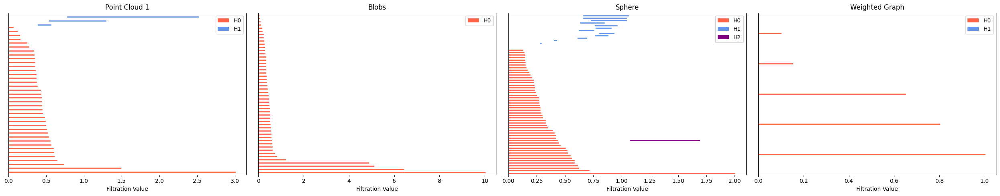

In [17]:
# Now plot all four barcode panels
fig, axs = plt.subplots(1, 4, figsize=(25, 5))

plot_barcode(dgm_pt_cloud1, r=3, dims=[0, 1], ax=axs[0])
axs[0].set_title("Point Cloud 1")

plot_barcode(dgm_blobs, r=10, dims=[0], ax=axs[1])
axs[1].set_title("Blobs")

plot_barcode(dgm_sphere, r=2, dims=[0, 1,2], ax=axs[2])
axs[2].set_title("Sphere")

plot_barcode(dgm_graph, r=1, dims=[0, 1], ax=axs[3])
axs[3].set_title("Weighted Graph")

plt.tight_layout()

plt.savefig('Figures/Barcodes.png')
plt.show()

# Animation of VR Complex and Barcode
The following animations illustrate how the Vietoris-Rips complex and its persistence barcode evolve together as the scale parameter increases.


## Animation For Point Cloud

In [22]:
# --- Animation setup ---
r_values = np.linspace(0.01, 3.0, 60)
fig, (ax_vr, ax_bar) = plt.subplots(1, 2, figsize=(15, 7))

def update(i):
    r = r_values[i]
    ax_vr.clear()
    ax_bar.clear()

    plot_VR(pt_cloud1, r, ax=ax_vr)
    ax_vr.set_title(f"VR Complex at $r = {r:.2f}$", fontsize=16)
    ax_vr.set_xticks(np.arange(-3.5,4,0.5))
    ax_vr.set_yticks(np.arange(-3.5,4,0.5))

    plot_barcode(dgm_pt_cloud1, r=r, dims=[0,1], ax=ax_bar)
    ax_bar.set_xlim([0,3])
    ax_bar.set_ylim([-0.2,10])

ani = FuncAnimation(fig, update, frames=len(r_values), interval=100, repeat=True)

writer = HTMLWriter(fps=10, embed_frames=True)
ani.save("All Animations/vr_barcode_animation_pt_cloud.html", writer=writer)

plt.close()
HTML(ani.to_jshtml())

## Animation For Blobs

In [28]:
# --- Animation setup ---
r_values = np.linspace(0.01, 10.0, 60)
fig, (ax_vr, ax_bar) = plt.subplots(1, 2, figsize=(15, 7))

def update(i):
    r = r_values[i]
    ax_vr.clear()
    ax_bar.clear()

    plot_VR(X_blobs, r, ax=ax_vr)
    ax_vr.set_title(f"VR Complex at $r = {r:.2f}$", fontsize=16)
    ax_vr.set_xticks(range(-10,10))
    ax_vr.set_yticks(range(-10,10))

    plot_barcode(dgm_blobs, r=r, dims=[0], ax=ax_bar)
    ax_bar.set_xlim([0,11])
    ax_bar.set_ylim([-0.2,10])

ani = FuncAnimation(fig, update, frames=len(r_values), interval=100, repeat=True)

writer = HTMLWriter(fps=10, embed_frames=True)
ani.save("All Animations/vr_barcode_animation_Blobs.html", writer=writer)

plt.close()
HTML(ani.to_jshtml())

## Animation For Sphere

In [30]:
r_values = np.linspace(0.01, 2.0, 30)

# Create custom figure and axes
fig = plt.figure(figsize=(15, 7))

# ax_vr is 3D
ax_vr = fig.add_subplot(1, 2, 1, projection='3d')

# ax_bar is 2D
ax_bar = fig.add_subplot(1, 2, 2)

def update(i):
    r = r_values[i]
    ax_vr.clear()
    ax_bar.clear()

    plot_VR(X_sphere, r, ax=ax_vr)
    ax_vr.set_title(f"VR Complex at $r = {r:.2f}$", fontsize=16)

    plot_barcode(dgm_sphere, r=r, dims=[0,1,2], ax=ax_bar)
    ax_bar.set_xlim([0, 2.2])
    ax_bar.set_ylim([-0.2, 10])

ani = FuncAnimation(fig, update, frames=len(r_values), interval=100, repeat=True)

writer = HTMLWriter(fps=10, embed_frames=True)
ani.save("All Animations/vr_barcode_animation_sphere.html", writer=writer)

plt.close()
HTML(ani.to_jshtml())


## Animation For Weighted Graph

In [32]:
# --- Animation setup ---
r_values = np.linspace(0.01, 1.0, 60)
fig, (ax_vr, ax_bar) = plt.subplots(1, 2, figsize=(15, 7))

def update(i):
    r = r_values[i]
    ax_vr.clear()
    ax_bar.clear()

    plot_VR_from_graph(G, r, ax=ax_vr)
    ax_vr.set_title(f"VR Complex at $r = {r:.2f}$", fontsize=16)

    plot_barcode(dgm_graph, r=r, dims=[0], ax=ax_bar)
    ax_bar.set_xlim([0,1.1])
    ax_bar.set_ylim([-0.2,10])

ani = FuncAnimation(fig, update, frames=len(r_values), interval=100, repeat=True)

writer = HTMLWriter(fps=10, embed_frames=True)
ani.save("All Animations/vr_barcode_animation_graph.html", writer=writer)

plt.close()
HTML(ani.to_jshtml())

## Animations All Together

In [43]:
# Expand output width in JupyterLab
display(HTML("<style>.output_wrapper, .output {width: 100% !important;}</style>"))

# HTML file map
html_files = {
    "Point Cloud": "All Animations/vr_barcode_animation_pt_cloud.html",
    "Blobs": "All Animations/vr_barcode_animation_Blobs.html",
    "Sphere": "All Animations/vr_barcode_animation_sphere.html",
    "Weighted Graph": "All Animations/vr_barcode_animation_graph.html"
}

# Dropdown selector
dropdown = widgets.Dropdown(
    options=html_files.keys(),
    description='Dataset:',
    layout=widgets.Layout(width='300px')
)

# Output area
output = widgets.Output()

def on_change(change):
    if change['type'] == 'change' and change['name'] == 'value':
        with output:
            output.clear_output()
            path = html_files[change['new']]
            display(IFrame(src=path, width='100%', height='850'))

# Hook event
dropdown.observe(on_change)

# Display UI
display(HTML("<h2>Persistent Homology Animation Viewer</h2>"))
display(dropdown)
display(output)

# Trigger first display
dropdown.value = "Point Cloud"


Dropdown(description='Dataset:', layout=Layout(width='300px'), options=('Point Cloud', 'Blobs', 'Sphere', 'Wei…

Output()